In [1]:
import os
import sys
sys.path.append(os.path.abspath("..")) 

import math
import time
import datetime
import numpy as np
from numpy.lib.stride_tricks import sliding_window_view
import torch
from torch.utils.data import Dataset
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
from torch.optim.lr_scheduler import CosineAnnealingLR
# from YourDataset import YourDataset  # Import your custom dataset here
from tqdm import tqdm
from torch.cuda.amp import autocast, GradScaler
from torchinfo import summary
import torchprofile

import pickle

torch.manual_seed(23)

scaler = GradScaler()

DTYPE = torch.float32
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)


import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams["figure.dpi"] = 300
plt.rcParams["font.family"] = "serif"
from contextlib import contextmanager
from matplotlib.colors import LogNorm, TwoSlopeNorm
from matplotlib.lines import Line2D


import scipy.stats as stats

Using device: cuda


# Loading data

In [2]:
true  = np.load(f"path/to/True.npy")
no    = np.load(f"path/to/NO_predictions.npy")
noadv = np.load(f"path/to/adv-NO_predictions.npy")
pino  = np.load(f"path/to/NO-div_predictions.npy")

temp  = np.load("path/to/GenCFD_predictions.npy")
gencfd = np.expand_dims(temp.transpose(1,0,2,3,4), axis=0)

pred_label_ls = ["DNS", "NO", "adv-NO", r"NO+$\nabla \cdot u$", "GenCFD"]
pred_ls = [true, no, noadv, pino, gencfd]

for i in range(len(pred_ls)):
    print(f"{pred_label_ls[i]}: {pred_ls[i].shape}")
    

DNS: (1, 4, 36, 128, 128, 128)
NO: (1, 4, 36, 128, 128, 128)
adv-NO: (1, 4, 36, 128, 128, 128)
NO+$\nabla \cdot u$: (1, 4, 36, 128, 128, 128)
GenCFD: (1, 4, 36, 128, 128, 128)


# Calculating Time Scale

In [3]:
nu = 1/90

def get_S(velocity):
    # data - [BS, nf, nt, nx, ny, nz]

    dx = dy = dz = 2*np.pi/128

    u, v, w = velocity[:,0], velocity[:,1], velocity[:,2]  # [BS, nt, nx, ny, nz]

    # Central differences (2nd-order)
    def ddx(f): return (np.roll(f, -1, axis=2) - np.roll(f, 1, axis=2)) / (2 * dx)
    def ddy(f): return (np.roll(f, -1, axis=3) - np.roll(f, 1, axis=3)) / (2 * dy)
    def ddz(f): return (np.roll(f, -1, axis=4) - np.roll(f, 1, axis=4)) / (2 * dz)

    # Velocity gradients ∂ui/∂xj
    du_dx, du_dy, du_dz = ddx(u), ddy(u), ddz(u)
    dv_dx, dv_dy, dv_dz = ddx(v), ddy(v), ddz(v)
    dw_dx, dw_dy, dw_dz = ddx(w), ddy(w), ddz(w)

    # Velocity gradient tensor (∇u)
    grad = np.array([
        [du_dx, du_dy, du_dz],
        [dv_dx, dv_dy, dv_dz],
        [dw_dx, dw_dy, dw_dz]
    ])  # shape [3, 3, BS, nt, nx, ny, nz]

    print(f"grad: {grad.shape}")

    gradT = np.transpose(grad, (1,0, 2, 3, 4,5,6))

    S = 0.5 * (grad + gradT)

    return S

    
    

def get_eps(data):
    # data - [BS, nf, nt, nx, ny, nz]

    S   = get_S(data)
    eps = 2 * nu * S * S #[3,3, BS, nt, nx, ny, nz] 

    eps = np.sum(eps, axis=(0,1)) #[BS, nt, nx, ny, nz]

    eps_sa = np.mean(eps, axis=(2,3,4))
    eps_avg = np.mean(eps_sa)

    return eps_avg



def get_rms(u):
    # u - [BS, nt, nx, ny, nz]
    u2 = u**2
    u2_ta = np.mean(u2, axis=1) #[BS, nx, ny, nz]
    u_ta = u2_ta**0.5
    rms = np.mean(u_ta)

    return rms

def get_u_rms(velocity):
    u,v,w = velocity[:,0], velocity[:,1], velocity[:,2] #[BS, nt, nx, ny, nz]
    u_rms = get_rms(u)
    v_rms = get_rms(v)
    w_rms = get_rms(w)

    out = 1/3 * (u_rms + v_rms + w_rms)

    return out

def get_ke(velocity):
    u,v,w = velocity[:,0], velocity[:,1], velocity[:,2]

    ke = 0.5 * np.mean( (u**2 + v**2 + w**2) )

    return ke

traj_train = np.load("/oscar/data/gk/voommen/no_diffusion/hit_3d/data_lam90/data.npy")[:,:160]
traj_train = np.expand_dims(traj_train, axis=0) #[1, nf, nt, nx, ny, nz]
print(f"traj_train: {traj_train.shape}")

eps = get_eps(traj_train)

print(f"eps: {eps}")

u_rms = get_u_rms(traj_train)
print(f"u_rms: {u_rms}")

ke = get_ke(traj_train)

TE1 = u_rms**2 / eps


print(f"TE1      : {TE1}")
print(f"TE1/del t: {TE1/0.04}")


traj_train: (1, 4, 160, 128, 128, 128)
grad: (3, 3, 1, 160, 128, 128, 128)
eps: 3.3633322715759277
u_rms: 0.9688666661580403
TE1      : 0.2790989830904681
TE1/del t: 6.977474577261702


In [4]:
def get_ke(x):
    u,v,w,_ = x
    ke = 0.5*(u**2 + v**2 + w**2)
    return ke

# Energy Spectrum

In [5]:

def compute_tke_spectrum_timeseries_torch(u_all, lx, ly, lz, smooth=False, device='cpu'):
    """
    Compute TKE spectrum over time without loops using PyTorch.
    
    Parameters:
    -----------
    u_all : torch.Tensor
        Tensor of shape [3, ntime, nx, ny, nz] with velocity components.
    lx, ly, lz : float
        Domain sizes.
    smooth : bool
        Apply optional smoothing.
    device : str
        Device to use.

    Returns:
    --------
    knyquist : float
    wave_numbers : torch.Tensor [maxbin]
    tke_spectrum : torch.Tensor [ntime, maxbin]
    """
    u_all = torch.tensor(u_all, dtype=DTYPE, device=device) # [3, ntime, nx, ny, nz]
    nf, ntime, nx, ny, nz = u_all.shape
    assert nf == 3, "First dimension must be 3 (velocity components)"

    ntot = nx * ny * nz

    # FFT
    uh_all = torch.fft.fftn(u_all, dim=(-3, -2, -1)) / ntot  # [3, ntime, nx, ny, nz]

    # Compute energy: sum of squares of real and imaginary parts
    energy = 0.5 * (uh_all.real**2 + uh_all.imag**2).sum(dim=0)  # [ntime, nx, ny, nz]

    # Wavenumber grids
    kx = torch.fft.fftfreq(nx, d=lx / nx, device=device)
    ky = torch.fft.fftfreq(ny, d=ly / ny, device=device)
    kz = torch.fft.fftfreq(nz, d=lz / nz, device=device)
    KX, KY, KZ = torch.meshgrid(kx, ky, kz, indexing='ij')
    K_mag = torch.sqrt(KX**2 + KY**2 + KZ**2)  # [nx, ny, nz]

    # Flatten for binning
    k_bins = torch.round(K_mag.flatten() / K_mag.max() * (nx // 2)).to(torch.int64)  # [npts]
    max_bin = k_bins.max().item() + 1

    wave_numbers = torch.arange(max_bin, device=device) * (2 * np.pi / ((lx + ly + lz)/3))

    # Flatten energy: [ntime, npts]
    energy_flat = energy.view(ntime, -1)  # [ntime, npts]

    # Allocate spectrum
    tke_spectrum = torch.zeros(ntime, max_bin, device=device)

    # Vectorized binning using broadcasting + scatter_add
    for k in range(max_bin):
        mask = (k_bins == k)
        if mask.any():
            tke_spectrum[:, k] = energy_flat[:, mask].sum(dim=1)

    if smooth:
        kernel = torch.ones(5, device=device) / 5
        kernel = kernel[None, None, :]
        tke_spectrum = torch.nn.functional.conv1d(
            tke_spectrum[:, None, :], kernel, padding=2
        ).squeeze(1)

    knyquist = (2 * np.pi / ((lx + ly + lz)/3)) * min(nx, ny, nz) / 2

    return knyquist, wave_numbers.detach().cpu().numpy(), tke_spectrum.detach().cpu().numpy()  # [ntime, maxbin]


/tmp/ipykernel_2453877/1707104959.py:18: RuntimeWarning: divide by zero encountered in power
  plt.loglog(wave_numbers, 10 * wave_numbers**(-5/3), label="slope = -5/3", color="magenta", ls="dotted")


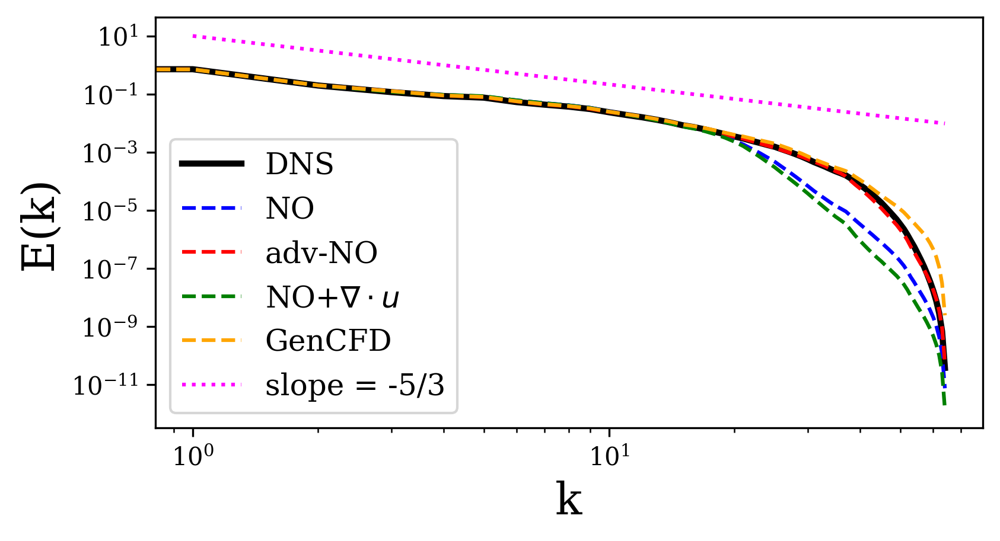

In [6]:
color_ls = ["black", "blue", "red", "green", "orange"]
lw_ls = [2.5, 1.5, 1.5, 1.5, 1.5]
ls_ls = ['-', '--', '--', '--', '--']

sample_id=0

spectrum_ls = []

fig = plt.figure(figsize=(6,3))
for i in range(len(pred_ls)):
    field = pred_ls[i]
    knyquist, wave_numbers, spectrum = compute_tke_spectrum_timeseries_torch( field[sample_id, :3], 2*np.pi, 2*np.pi, 2*np.pi, device=device  )
    spectrum_ls.append(np.log(spectrum) )
    # spectrum = spectrum[35] 
    spectrum = np.mean(spectrum, axis=0)
    plt.loglog(wave_numbers, spectrum, label=pred_label_ls[i], color=color_ls[i], lw=lw_ls[i], ls=ls_ls[i])

plt.loglog(wave_numbers, 10 * wave_numbers**(-5/3), label="slope = -5/3", color="magenta", ls="dotted")

plt.legend(fontsize = 12)
plt.xlabel("k", fontsize = 18)
plt.ylabel("E(k)", fontsize=18)

plt.show()

# Error Comparisons

In [7]:
def get_err(T, P, kind="minmax"):
    MIN = np.min(T) #min(np.min(T), np.min(P))
    MAX = np.max(T) #max(np.max(T), np.max(P))
    MEAN = np.mean(T)
    STD  = np.std(T)
    if kind=="minmax":
        shift = MIN
        scale = MAX-MIN
    elif kind=="meanstd":
        shift=MEAN
        scale=STD
    elif kind=="zeroone":
        shift=0
        scale=1
        

    T = (T-shift)/scale
    P = (P-shift)/scale
    
    # return np.mean(  np.sqrt(np.mean( (T-P)**2, axis=(2,3) ))  )
    return  np.mean( (T-P)**2 )**0.5



In [8]:
field_err_ls = []
spec_err_ls = []

for i in range(1,len(pred_ls)):
    field_err_ls.append(get_err(pred_ls[0], pred_ls[i]))
    spec_err_ls.append(get_err(spectrum_ls[0], spectrum_ls[i]))

In [9]:
print(pred_label_ls)
print(f"field_err_ls: ", field_err_ls)
print(f"spec_err_ls: ", spec_err_ls)

['DNS', 'NO', 'adv-NO', 'NO+$\\nabla \\cdot u$', 'GenCFD']
field_err_ls:  [0.032668621945718596, 0.02647433761687969, 0.03201895003717965, 0.03271672613507358]
spec_err_ls:  [0.08651210762398484, 0.02348155237801318, 0.12624064570180143, 0.05873694010286266]


In [10]:
for err in field_err_ls:
    print(f"{err:.4f}")

0.0327
0.0265
0.0320
0.0327


In [11]:
for err in spec_err_ls:
    print(f"{err:.4f}")

0.0865
0.0235
0.1262
0.0587


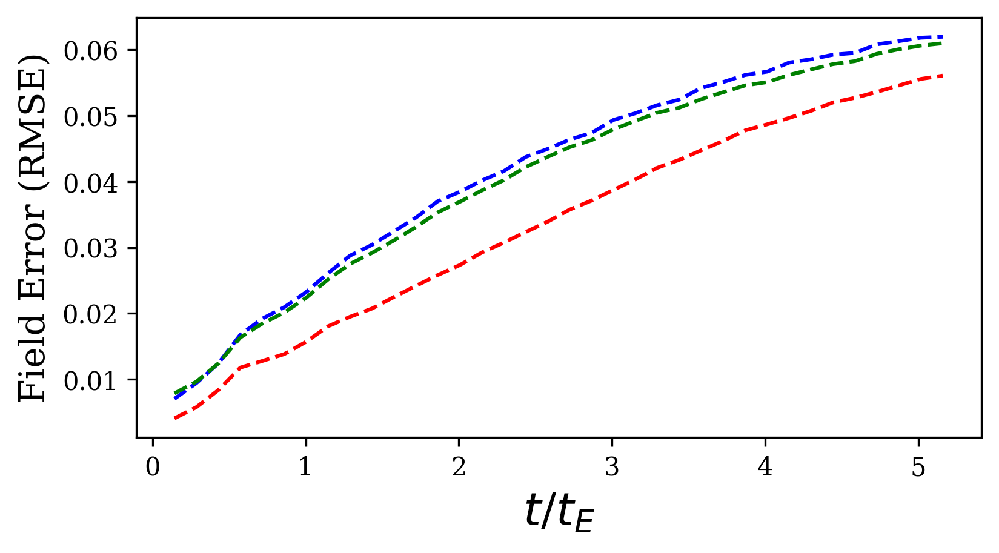

In [12]:
def get_err(TRUE, PRED):
    true = 0.5 * (TRUE[0]**2 + TRUE[1]**2 + TRUE[2]**2)
    pred = 0.5 * (PRED[0]**2 + PRED[1]**2 + PRED[2]**2)

    MIN = np.min(true)
    MAX = np.max(true)

    true = (true-MIN)/(MAX - MIN)
    pred = (pred-MIN)/(MAX - MIN)
    
    err = np.sqrt( np.mean( (true-pred)**2, axis=(1,2,3)  ) ) #/ np.sqrt( np.mean( (true)**2, axis=(1,2,3)  ) )
    # err = np.mean(err, axis=(0))
    return err

fig = plt.figure(figsize=(6,3))

t_ls = (1+np.arange(true.shape[2]))
time_ls = t_ls * 0.04/TE1

for i in range(1, len(pred_ls)-1):
    err = get_err(pred_ls[0][0], pred_ls[i][0])
    plt.plot(time_ls, err, color=color_ls[i], ls=ls_ls[i], lw=lw_ls[i], label=f"{pred_label_ls[i]}")

plt.xticks([0,1,2,3,4,5])
plt.ylabel(f"Field Error (RMSE)", fontsize=14)
plt.xlabel(f"$t$/$t_E$", fontsize=18)
# plt.ylim(0,0.075)
plt.show()

# QR Plots

In [13]:
import numpy.fft as fft

def _dk(N, L):
    # Spectral wavenumbers for periodic domain length L with N points
    k = 2.0*np.pi*fft.fftfreq(N, d=L/N)
    return k.astype(np.float64)

def _d_dx_fft(f, kx, axis):
    F = fft.fftn(f, axes=(0,1,2))
    # multiply by i*k along the chosen axis
    if axis == 0:
        dF = 1j*kx[:,None,None] * F
    elif axis == 1:
        dF = 1j*kx[None,:,None] * F
    else:
        dF = 1j*kx[None,None,:] * F
    return np.real(fft.ifftn(dF, axes=(0,1,2)))

def velocity_gradients(u, v, w, Lx, Ly, Lz, method="fft"):
    """
    Return all nine components of A = grad(u) with shape [nx,ny,nz] each.
    """
    nx, ny, nz = u.shape
    if method == "fft":
        kx, ky, kz = _dk(nx, Lx), _dk(ny, Ly), _dk(nz, Lz)
        du_dx = _d_dx_fft(u, kx, axis=0); du_dy = _d_dx_fft(u, ky, axis=1); du_dz = _d_dx_fft(u, kz, axis=2)
        dv_dx = _d_dx_fft(v, kx, axis=0); dv_dy = _d_dx_fft(v, ky, axis=1); dv_dz = _d_dx_fft(v, kz, axis=2)
        dw_dx = _d_dx_fft(w, kx, axis=0); dw_dy = _d_dx_fft(w, ky, axis=1); dw_dz = _d_dx_fft(w, kz, axis=2)
    else:
        dx, dy, dz = Lx/nx, Ly/ny, Lz/nz
        du_dx, du_dy, du_dz = np.gradient(u, dx, dy, dz, edge_order=2)
        dv_dx, dv_dy, dv_dz = np.gradient(v, dx, dy, dz, edge_order=2)
        dw_dx, dw_dy, dw_dz = np.gradient(w, dx, dy, dz, edge_order=2)

    return (du_dx, du_dy, du_dz,
            dv_dx, dv_dy, dv_dz,
            dw_dx, dw_dy, dw_dz)

def invariants_QR_from_field(field4, Lx, Ly, Lz, method="fft"):
    """
    field4: np.ndarray float64, shape [4, nx, ny, nz] with channels [u,v,w,P]
    returns Q, R as flat 1D arrays (masking nans/infs)
    """
    field4 = field4.astype(np.float64, copy=False)
    u, v, w = field4[0], field4[1], field4[2]

    (u_x, u_y, u_z,
     v_x, v_y, v_z,
     w_x, w_y, w_z) = velocity_gradients(u, v, w, Lx, Ly, Lz, method=method)

    # Build A = grad(u)
    # A components (row i = velocity component, col j = spatial derivative wrt x_j)
    A11, A12, A13 = u_x, u_y, u_z
    A21, A22, A23 = v_x, v_y, v_z
    A31, A32, A33 = w_x, w_y, w_z

    # Make traceless: A' = A - (theta/3) I, theta = div u
    theta = (A11 + A22 + A33) / 1.0
    A11p = A11 - theta/3.0; A22p = A22 - theta/3.0; A33p = A33 - theta/3.0
    # A11p, A22p, A33p = A11, A22, A33
    A12p, A13p = A12, A13
    A21p, A23p = A21, A23
    A31p, A32p = A31, A32

    # Q = -1/2 tr(A'^2)
    trA2 = (A11p*A11p + A22p*A22p + A33p*A33p
            + 2*(A12p*A21p + A13p*A31p + A23p*A32p))
    Q = -0.5 * trA2

    # R = -det(A')
    # det of 3x3 explicitly
    detA = (
        A11p*(A22p*A33p - A23p*A32p)
        - A12p*(A21p*A33p - A23p*A31p)
        + A13p*(A21p*A32p - A22p*A31p)
    )
    R = -detA

    A2 = (A11p*A11p + A22p*A22p + A33p*A33p +
          2*(A12p*A12p + A13p*A13p + A23p*A23p +
             A21p*A21p + A31p*A31p + A32p*A32p))
    A2_mean = np.mean(A2)

    q = Q.ravel() / A2_mean
    r = R.ravel() / (A2_mean**1.5)
    m = np.isfinite(q) & np.isfinite(r)
    return q[m], r[m]

def plot_qr_pdf(Q, R, bins=400, q_limits=None, r_limits=None, title="QR distribution"):
    # Robust ranges using percentiles if not provided
    if q_limits is None:
        qlo, qhi = np.percentile(Q, [0.2, 99.8])
        q_pad = 0.05*(qhi-qlo)
        q_limits = (qlo-q_pad, qhi+q_pad)
    if r_limits is None:
        rlo, rhi = np.percentile(R, [0.2, 99.8])
        r_pad = 0.05*(rhi-rlo)
        r_limits = (rlo-r_pad, rhi+r_pad)

    H, r_edges, q_edges = np.histogram2d(R, Q, bins=bins,
                                         range=[r_limits, q_limits])
    H = H.T  # for imshow (rows = Q)

    fig, ax = plt.subplots(figsize=(6,6), constrained_layout=True)
    im = ax.imshow(H, origin='lower',
                   extent=[r_edges[0], r_edges[-1], q_edges[0], q_edges[-1]],
                   aspect='auto', norm=LogNorm(vmin=max(H[H>0].min(), 1.0), vmax=H.max()), cmap="turbo")
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Counts (log)')

    # Vieillefosse line: Q^3 + (27/4) R^2 = 0  => Q = - (27/4)^{2/3} * |R|^{2/3} * sign? (plot branches parametrically)
    r = np.linspace(r_limits[0], r_limits[1], 2000)
    q_v = - (27.0/4.0)**(1.0/3.0) * np.abs(r)**(2.0/3.0)
    ax.plot(r, q_v, 'k--', linewidth=1.2, label=r'$(27/4)R^2 + Q^3 = 0$')

    ax.set_xlabel(r'$R$')
    ax.set_ylabel(r'$Q$')
    ax.set_title(title)
    ax.legend(loc='upper left', frameon=True)
    plt.show()


In [14]:
def hist2d(Qs, Rs, bins=300, qlim=None, rlim=None, eps=1e-12):
    if qlim is None:
        qlo, qhi = np.percentile(Qs, [0.2, 99.8]); qpad = 0.05*(qhi-qlo); qlim = (qlo-qpad, qhi+qpad)
    if rlim is None:
        rlo, rhi = np.percentile(Rs, [0.2, 99.8]); rpad = 0.05*(rhi-rlo); rlim = (rlo-rpad, rhi+rpad)
    H, r_edges, q_edges = np.histogram2d(Rs, Qs, bins=bins, range=[rlim, qlim])
    H = H.T
    H = (H + eps) / (H.sum() + eps*H.size)  # proper PDF
    return H, r_edges, q_edges

def overlay_dns_vs_model(H_dns, H_mod, r_edges_true, q_edges_true, r_edges_mod, q_edges_mod, title="Q–R comparison", pred_color="magenta", label=""):
    extent = [r_edges_true[0], r_edges_true[-1], q_edges_true[0], q_edges_true[-1]]
    fig, ax = plt.subplots(figsize=(5,5), constrained_layout=True)

    # DNS as filled image
    # im = ax.imshow(H_dns, origin='lower', extent=extent, aspect='auto',
    #                norm=LogNorm(vmin=max(H_dns[H_dns>0].min(), 1e-6), vmax=H_dns.max()), cmap='Spectral')
    # cbar = plt.colorbar(im, ax=ax); cbar.set_label('DNS PDF (log)')

    # Model as contours at fixed probability levels (log-spaced)
    levels = np.logspace(np.log10(H_dns.max())-3, np.log10(H_dns.max())-1, 4)
    Rg = 0.5*(r_edges_mod[:-1] + r_edges_mod[1:])
    Qg = 0.5*(q_edges_mod[:-1] + q_edges_mod[1:])
    ax.contour(Rg, Qg, H_mod, levels=levels, colors=pred_color, linewidths=1.0, label=label)

    Rg = 0.5*(r_edges_true[:-1] + r_edges_true[1:])
    Qg = 0.5*(q_edges_true[:-1] + q_edges_true[1:])
    ax.contour(Rg, Qg, H_true, levels=levels, colors='black', linewidths=1.0, label="DNS")

    # Vieillefosse line
    min_r, max_r = min(np.min(r_edges_true), np.min(r_edges_mod)), max(np.max(r_edges_true), np.max(r_edges_mod))
    r = np.linspace(min_r, max_r, 2000)
    q_v = - (27.0/4.0)**(1.0/3.0) * np.abs(r)**(2.0/3.0)
    ax.plot(r, q_v, 'k--', lw=1.1, color='magenta', label=r'$(27/4)R^2+Q^3=0$')

    # Mark modes
    i_dns, j_dns = np.unravel_index(H_dns.argmax(), H_dns.shape)
    i_mod, j_mod = np.unravel_index(H_mod.argmax(), H_mod.shape)
    # ax.plot(0.5*(r_edges_true[j_dns:j_dns+2].sum()), 0.5*(q_edges_true[i_dns:i_dns+2].sum()), 'wo', ms=6, mec='k', label='DNS mode')
    # ax.plot(0.5*(r_edges_mod[j_mod:j_mod+2].sum()), 0.5*(q_edges_mod[i_mod:i_mod+2].sum()), 'r^', ms=6, mec='k', label='Model mode')

    # ax.set_xlabel(r'$R^*$'); ax.set_ylabel(r'$Q^*$'); ax.set_title(title)
    if label=="NO":
        handles = [
            Line2D([0],[0], ls='--', color='k', label=r'$(27/4)R^2+Q^3=0$'),  # Vieillefosse
            Line2D([0],[0], color="black", label="DNS"),
            Line2D([0],[0], color=pred_color, label=label),        # your ax.contour
            # Patch(facecolor='none', edgecolor='none', label='DNS PDF (see colorbar)')  # optional
        ]
    else:
        handles = [
            Line2D([0],[0], color=pred_color, label=label),        # your ax.contour
            # Patch(facecolor='none', edgecolor='none', label='DNS PDF (see colorbar)')  # optional
        ]
    ax.legend(handles=handles, loc='upper left', frameon=True, fontsize=16)
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_ylim(-1, 0.8)
    # ax.legend(loc='upper left', frameon=True)
    plt.show()


In [15]:
color_ls = ["black", "blue", "red", "green", "orange"]

/tmp/ipykernel_2453877/2282029795.py:24: UserWarning: The following kwargs were not used by contour: 'label'
  ax.contour(Rg, Qg, H_mod, levels=levels, colors=pred_color, linewidths=1.0, label=label)
/tmp/ipykernel_2453877/2282029795.py:28: UserWarning: The following kwargs were not used by contour: 'label'
  ax.contour(Rg, Qg, H_true, levels=levels, colors='black', linewidths=1.0, label="DNS")
/tmp/ipykernel_2453877/2282029795.py:34: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  ax.plot(r, q_v, 'k--', lw=1.1, color='magenta', label=r'$(27/4)R^2+Q^3=0$')
/tmp/ipykernel_2453877/3305403417.py:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.92])
/tmp/ipykernel_2453877/3305403417.py:92: UserWarning: The figure layout has changed to tight
  plt.tight_layout(rect=[0, 0, 1, 0.9

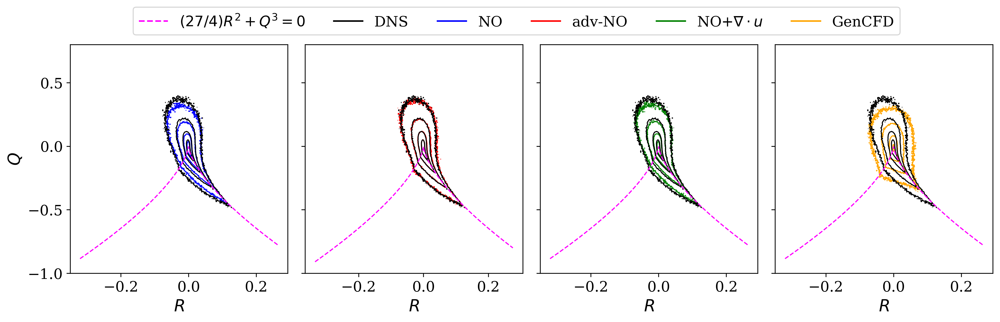

In [16]:
@contextmanager
def draw_into(fig, ax):
    """Temporarily patch plt.subplots/plt.show so overlay_dns_vs_model draws into (fig, ax)."""
    orig_subplots = plt.subplots
    orig_show = plt.show
    try:
        plt.subplots = lambda *a, **k: (fig, ax)
        plt.show = lambda *a, **k: None   # avoid premature figure display inside overlay
        yield
    finally:
        plt.subplots = orig_subplots
        plt.show = orig_show

# ---------------- data prep (same as you do) ----------------
sample_id = 0
t_id = 35
Lx = Ly = Lz = 2*np.pi

color_ls = ["black", "blue", "red", "green", "orange"]  # indices 1..4 used for models

# DNS (index 0)
temp = pred_ls[0][sample_id, :, t_id].transpose(0,3,2,1)
Q_true, R_true = invariants_QR_from_field(temp, Lx, Ly, Lz, method="fft")
H_true, r_edges_true, q_edges_true = hist2d(Q_true, R_true)

# ---------------- figure layout ----------------
fig = plt.figure(figsize=(16, 4), constrained_layout=True)
gs = matplotlib.gridspec.GridSpec(1, 4, figure=fig, wspace=0.08)
axes = [fig.add_subplot(gs[0, j]) for j in range(4)]

# Panels for models 1..4
for j, ii in enumerate(range(1, 5)):
    ax = axes[j]

    temp = pred_ls[ii][sample_id, :, t_id].transpose(0,3,2,1)
    Q_mod, R_mod = invariants_QR_from_field(temp, Lx, Ly, Lz, method="fft")
    H_mod, r_edges_mod, q_edges_mod = hist2d(Q_mod, R_mod)

    # Draw using YOUR function, but into our target axes
    with draw_into(fig, ax):
        overlay_dns_vs_model(
            H_true, H_mod,
            r_edges_true, q_edges_true,
            r_edges_mod, q_edges_mod,
            pred_color=color_ls[ii],
            label=pred_label_ls[ii]  # keep your legend behavior (full only when label == "NO")
        )

    # Post-formatting for the grid
    ax.set_xlabel(r"$R$", fontsize=16)
    if j == 0:
        ax.set_ylabel(r"$Q$", fontsize=16)
    else:
        ax.set_ylabel("")
        ax.tick_params(labelleft=False)  # hide y tick labels on columns 2–4

# Optional: uniform y-limit like you had inside overlay
for ax in axes:
    ax.set_ylim(-1, 0.8)

# Optional titles:
# for ax, lab in zip(axes, pred_label_ls[1:5]):
#     ax.set_title(lab)

# plt.show()

for ax in axes:
    lg = ax.get_legend()
    if lg:
        lg.remove()

# 2) Build one row of handles for a top legend
handles = [
    Line2D([0],[0], ls='--', color='magenta', label=r'$(27/4)R^2+Q^3=0$'),  # Vieillefosse
    Line2D([0],[0], color='k', label='DNS'),                           # DNS
] + [
    Line2D([0],[0], color=color_ls[ii], label=pred_label_ls[ii])       # Models
    for ii in range(1, 5)
]

# 3) Figure-level legend in a single row
fig.legend(
    handles=handles,
    loc='upper center',
    ncol=len(handles),
    frameon=True,
    fontsize=14,
    bbox_to_anchor=(0.5, 1.03)   # nudge above axes
)

# 4) Leave room for the legend
plt.tight_layout(rect=[0, 0, 1, 0.92])
plt.show()

# Visualizations

In [17]:
temp = "tcunet_lb4_lf4_periodic"

true  = np.load(f"path/to/True.npy")
no    = np.load(f"path/to/NO_predictions.npy")
noadv = np.load(f"path/to/adv-NO_predictions.npy")
pino  = np.load(f"path/to/NO-div_predictions.npy")

pred_label_ls = ["DNS", "NO", "adv-NO", r"NO+$\nabla \cdot u$"]
pred_ls = [true, no, noadv, pino]

for i in range(len(pred_ls)):
    print(f"{pred_label_ls[i]}: {pred_ls[i].shape}")
    

DNS: (1, 4, 36, 128, 128, 128)
NO: (1, 4, 36, 128, 128, 128)
adv-NO: (1, 4, 36, 128, 128, 128)
NO+$\nabla \cdot u$: (1, 4, 36, 128, 128, 128)


In [18]:
import pyvista as pv
pv.start_xvfb()

color_ls = ["black", "blue", "red", "green"]
lw_ls = [2.5, 1.5, 1.5, 1.5]
ls_ls = ['-', '--', '--', '--']

In [19]:
import numpy as np
import pyvista as pv
import matplotlib.pyplot as plt

def plot_volume_rendering(field, clim, title="", CMAP="viridis", opacity=0.2, show_colorbar=True, make_transparent=False):
    # Extract the 3D scalar field for a given id
    volume = field  # Shape: [nx, ny, nz]

    # print(volume.shape)

    # Create PyVista ImageData for volume rendering
    grid = pv.ImageData(dimensions=np.array(volume.shape) + 1)
    grid.spacing = (1, 1, 1)  # Modify as needed
    grid.origin = (0, 0, 0)
    
    # Assign volume data to cell data
    grid.cell_data["KE"] = volume.flatten(order="F")

    # Set up PyVista plotter (offscreen)
    plotter = pv.Plotter(off_screen=True)

    # Define an opacity mapping
    opacity = opacity #[0.0, 0.02, 0.05, 0.1, 0.3, 0.6, 1.0]

    # Add volume rendering
    plotter.add_volume(
        grid,
        scalars="KE",
        opacity=opacity,
        cmap=CMAP,
        clim=clim,  # Adjust as needed
        show_scalar_bar=False
    )

    # Optional: Add bounding box
    plotter.add_bounding_box(color='grey', line_width=1.0)

    if show_colorbar:
        cbar = plotter.add_scalar_bar(
            title="",
            n_labels=5,
            vertical=True,
            position_x=0.88,   # x‐fraction (0–1), 0.85 pushes it to the right
            position_y=0.2,    # y‐fraction (0–1), 0.2 moves it up from bottom
            width=0.1,         # fraction of window width
            height=0.6         # fraction of window height
        )
        # Increase tick label font size
        cbar.GetLabelTextProperty().SetFontSize(36)
        cbar.GetLabelTextProperty().SetFontFamilyToTimes()
        # Force all tick labels to use two decimals (e.g. 1.23 instead of 1.231)
        cbar.SetLabelFormat("%.2f")


    # Camera configuration: placed to see all three slices
    center = np.array(grid.bounds[1::2]) / 2
    diagonal_vector = np.array([1, 1, 0.7])  # adjust if you want a different angle
    camera_distance = 1.5 * np.linalg.norm(grid.bounds[1::2])
    camera_position = center + camera_distance * diagonal_vector
    plotter.camera_position = [camera_position, center, [0, 0, 1]]


    light = pv.Light(
        position=camera_position,
        focal_point=center,
        color='white',
        light_type='scenelight'  # ensures it lights the entire scene
    )
    plotter.add_light(light)

    # Take a screenshot (returns an RGB image array)
    if make_transparent==False:
        image = plotter.screenshot(return_img=True, window_size=[1200, 1200])
        plotter.close()


        # 4) Crop with a small white margin (pad = 10 pixels)
        arr = image  # shape [H, W, 3], dtype=uint8
        white = np.array([255, 255, 255], dtype=np.uint8)
        tol = 1
    
        H, W, _ = arr.shape
    
        # Identify rows that are (nearly) all white
        is_row_white = np.all(np.abs(arr - white) <= tol, axis=(1, 2))
        nonwhite_rows = np.where(~is_row_white)[0]
        if nonwhite_rows.size:
            top, bottom = nonwhite_rows[0], nonwhite_rows[-1]
        else:
            top, bottom = 0, H - 1
    
        # Identify columns that are (nearly) all white
        is_col_white = np.all(np.abs(arr - white) <= tol, axis=(0, 2))
        nonwhite_cols = np.where(~is_col_white)[0]
        if nonwhite_cols.size:
            left, right = nonwhite_cols[0], nonwhite_cols[-1]
        else:
            left, right = 0, W - 1
    
        # Add padding but clamp to image bounds
        pad = 10
        top = max(0, top - pad)
        bottom = min(H - 1, bottom + pad)
        left = max(0, left - pad)
        right = min(W - 1, right + pad)
    
        cropped = arr[top: bottom + 1, left: right + 1, :]
    
        return cropped

    else: 
        plotter.set_background('white', top=None)
        plotter.background_alpha = 0.0
        
        image = plotter.screenshot(return_img=True, transparent_background=True, window_size=[1200, 1200])
        plotter.close()

        return image
    

        


def plot_midplane_slices(field, clim, title="", CMAP="viridis", show_colorbar=True):
    """
    Visualize only the three central orthogonal slices (XY, YZ, XZ) of a 3D volume.
    - field: 3D NumPy array of shape [nx, ny, nz]
    - clim: [min, max] color limits
    - title: optional title (not used in off-screen render)
    - CMAP: colormap name
    """
    volume = field
    nx, ny, nz = volume.shape

    # Create a PyVista ImageData object with cell scalars "KE"
    grid = pv.ImageData(dimensions=np.array(volume.shape) + 1)
    grid.spacing = (1, 1, 1)
    grid.origin = (0, 0, 0)
    grid.cell_data["KE"] = volume.flatten(order="F")

    # Compute mid‐coordinates in world‐space
    mid_x = nx / 2.0
    mid_y = ny / 2.0
    mid_z = nz / 2.0

    # Generate the three orthogonal slices at mid‐planes
    slices = grid.slice_orthogonal(x=mid_x, y=mid_y, z=mid_z)

    # Set up an off‐screen PyVista Plotter
    plotter = pv.Plotter(off_screen=True)

    # 1) Make the overall background white (so unused viewport area isn't black)
    plotter.set_background("white")
    
    # Shrink the 3D render area to the left 80% of the window
    # plotter.renderer.SetViewport(0.0, 0.0, 0.8, 1.0)

    # # 2) Force the leftover right 20% to white
    # plotter.renderer.SetBackground(1.0, 1.0, 1.0)

    # Add each slice to the scene
    for block in slices:
        plotter.add_mesh(
            block,
            scalars="KE",
            cmap=CMAP,
            clim=clim,
            show_scalar_bar=False  # disable per‐slice bar
        )

    # Optional: add a bounding box
    plotter.add_bounding_box(color="grey", line_width=1.0)

    # Add a single vertical colorbar on the right
    if show_colorbar:
        cbar = plotter.add_scalar_bar(
            title="",
            n_labels=5,
            vertical=True,
            position_x=0.86,  # shift to the right
            position_y=0.2,
            width=0.1,
            height=0.6,
        )
    
        # Increase tick label font size
        cbar.GetLabelTextProperty().SetFontSize(36)
        cbar.GetLabelTextProperty().SetFontFamilyToTimes()
        # Force all tick labels to use two decimals (e.g. 1.23 instead of 1.231)
        cbar.SetLabelFormat("%.2f")

    # Camera configuration: placed to see all three slices
    center = np.array(grid.bounds[1::2]) / 2
    diagonal_vector = np.array([1, 1, 0.7])  # adjust if you want a different angle
    camera_distance = 1.5 * np.linalg.norm(grid.bounds[1::2])
    camera_position = center + camera_distance * diagonal_vector
    plotter.camera_position = [camera_position, center, [0, 0, 1]]

    # Camera configuration similar to your isosurface function

    # offset = np.array([0,20,0])
    # center = np.array(grid.bounds[1::2]) / 2 + offset
    # dv = np.array([1, 0.9, 0.7])
    # diagonal_vector = dv/( (dv[0]**2 + dv[1]**2 + dv[2]**2)**0.5 )
    # camera_distance = 2 * np.linalg.norm(grid.bounds[1::2])
    # camera_position = center + camera_distance * diagonal_vector
    # plotter.camera_position = [camera_position, center, [0, 0, 1]]

    # Add a light source at the camera position, pointing toward the center
    light = pv.Light(
        position=camera_position,
        focal_point=center,
        color='white',
        light_type='scenelight'  # ensures it lights the entire scene
    )
    plotter.add_light(light)

    # Take a screenshot (returns an RGB image array)
    image = plotter.screenshot(return_img=True, window_size=[1200, 1200])
    plotter.close()

    # 4) Crop with a small white margin (pad = 10 pixels)
    arr = image  # shape [H, W, 3], dtype=uint8
    white = np.array([255, 255, 255], dtype=np.uint8)
    tol = 1

    H, W, _ = arr.shape

    # Identify rows that are (nearly) all white
    is_row_white = np.all(np.abs(arr - white) <= tol, axis=(1, 2))
    nonwhite_rows = np.where(~is_row_white)[0]
    if nonwhite_rows.size:
        top, bottom = nonwhite_rows[0], nonwhite_rows[-1]
    else:
        top, bottom = 0, H - 1

    # Identify columns that are (nearly) all white
    is_col_white = np.all(np.abs(arr - white) <= tol, axis=(0, 2))
    nonwhite_cols = np.where(~is_col_white)[0]
    if nonwhite_cols.size:
        left, right = nonwhite_cols[0], nonwhite_cols[-1]
    else:
        left, right = 0, W - 1

    # Add padding but clamp to image bounds
    pad = 10
    top = max(0, top - pad)
    bottom = min(H - 1, bottom + pad)
    left = max(0, left - pad)
    right = min(W - 1, right + pad)

    cropped = arr[top: bottom + 1, left: right + 1, :]

    return cropped



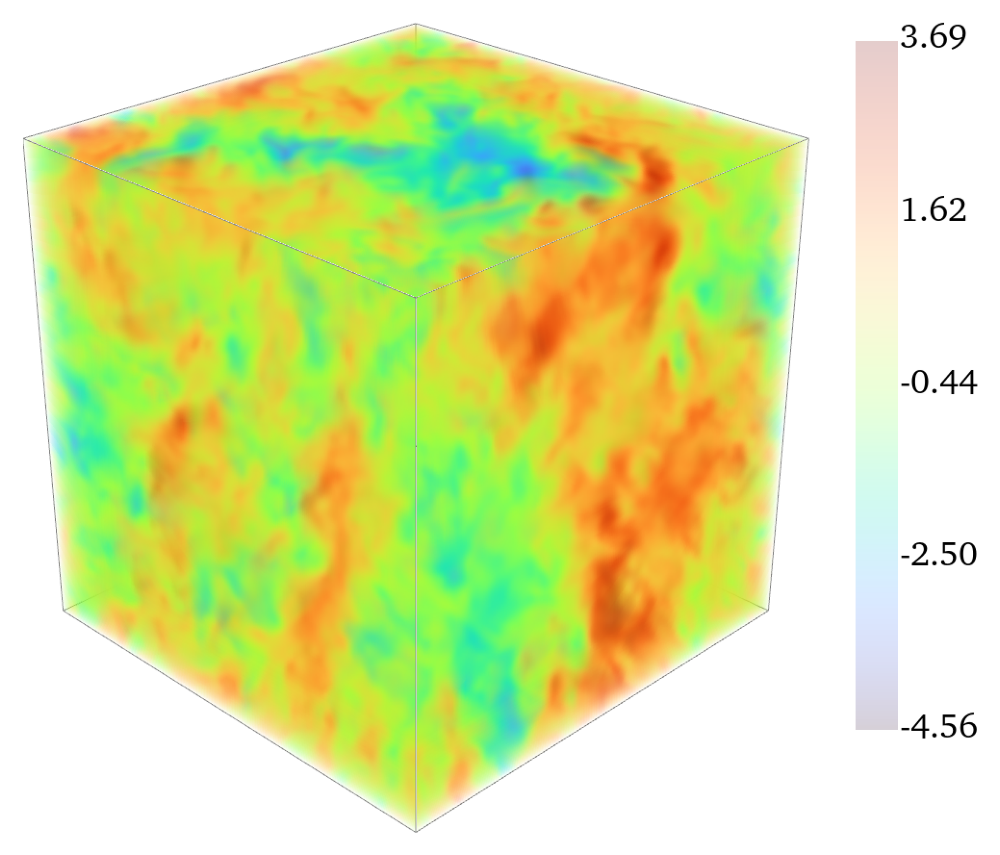

In [20]:
sample_id = 0
f_id = 0
t_id = 0

field = true[sample_id, f_id, t_id]
VMIN = np.min(field)
VMAX = np.max(field)

image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP='turbo')
# image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP='viridis')


plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis("off")
# plt.title(title)
plt.show()

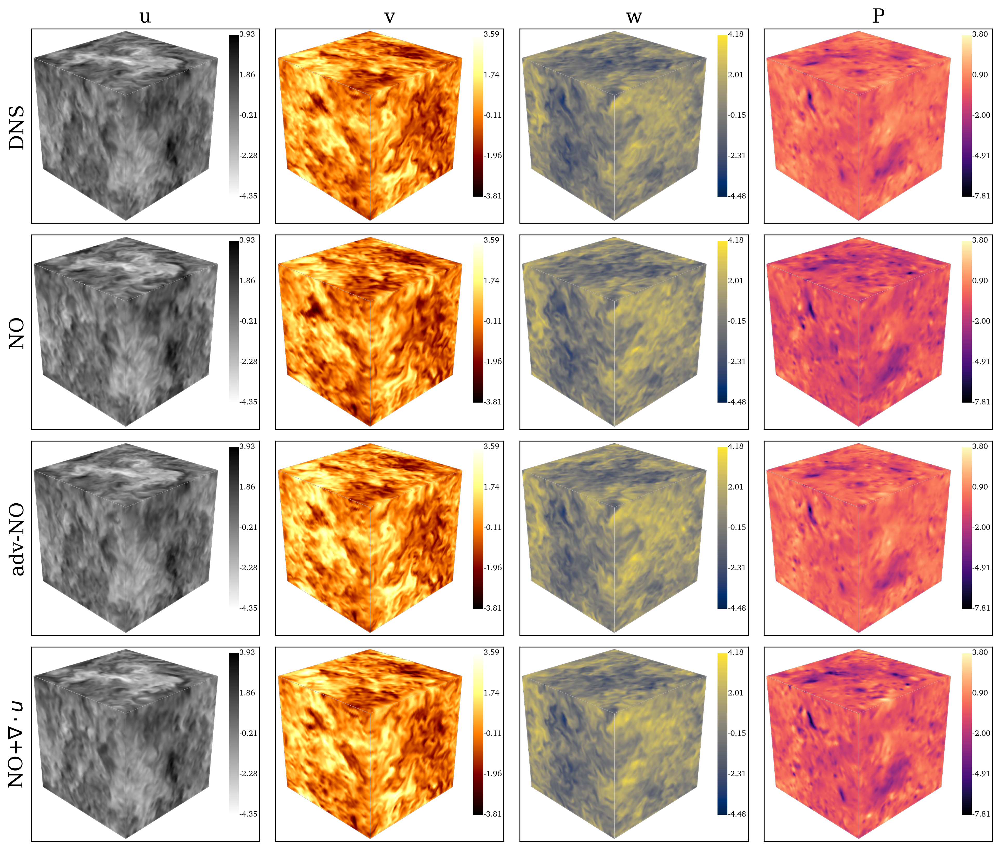

In [21]:
sample_id = 0
t_id = 13

fig, axes = plt.subplots(4,4, figsize=(13,11))

VMIN_ls = np.min(true, axis=(0,3,4,5))
VMAX_ls = np.max(true, axis=(0,3,4,5))
cmap_ls = ['binary', 'afmhot', 'cividis', 'magma']
title_ls = ['u', 'v', 'w', 'P']

for i in range(4):
    for j in range(4):
        f_id = j
        VMIN = VMIN_ls[f_id, t_id]
        VMAX = VMAX_ls[f_id, t_id]

        field = pred_ls[i][sample_id, f_id, t_id]
        image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], opacity=1)
        # image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id])

        ax = axes[i][j]
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(image)

        if i==0:
            ax.set_title(title_ls[f_id], fontsize=18)

        if j==0:
            ax.set_ylabel(pred_label_ls[i], fontsize=18)

plt.tight_layout()
plt.show()
        

In [22]:
ke_ls = []
spectrum_ls = []
for i in range(len(pred_ls)):
    # print(pred_ls[i].shape)
    ke = 1/2 * (pred_ls[i][:, 0:1]**2 + pred_ls[i][:, 1:2]**2 + pred_ls[i][:, 2:3]**2)
    knyquist, wave_numbers, spectrum = compute_tke_spectrum_timeseries_torch( pred_ls[i][0, :3], 2*np.pi, 2*np.pi, 2*np.pi, device=device  )
    print(ke.shape)
    print(spectrum.shape)
    ke_ls.append(ke)
    spectrum_ls.append(spectrum)
    

(1, 1, 36, 128, 128, 128)
(36, 65)
(1, 1, 36, 128, 128, 128)
(36, 65)
(1, 1, 36, 128, 128, 128)
(36, 65)
(1, 1, 36, 128, 128, 128)
(36, 65)


/tmp/ipykernel_2453877/3818483416.py:47: RuntimeWarning: divide by zero encountered in power
  ax.loglog(wave_numbers, 10 * wave_numbers**(-5/3), label="slope = -5/3", color="magenta", ls="dotted")


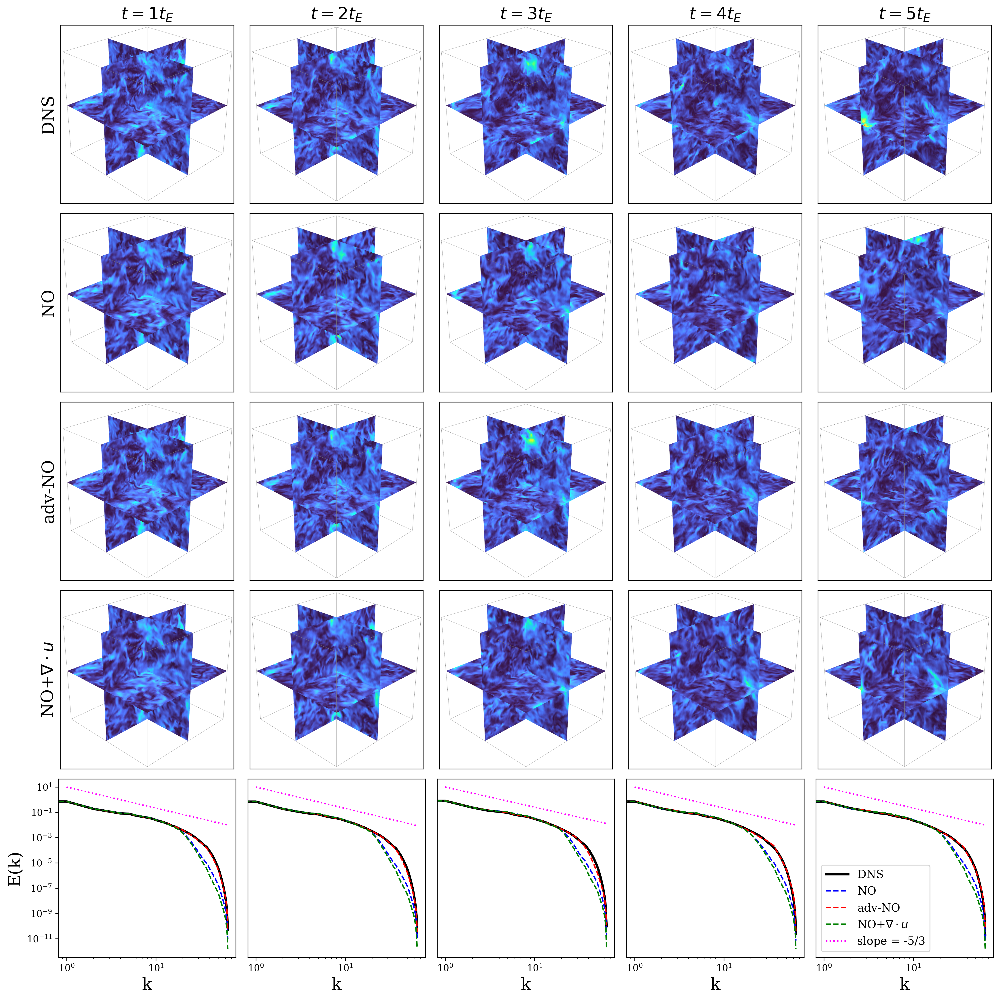

In [23]:
sample_id = 0
f_id = 0

fig, axes = plt.subplots(5,5, figsize=(15,15))

VMIN_ls = np.min(ke_ls[0]) #, axis=(0,3,4,5))
VMAX_ls = np.max(ke_ls[0]) #, axis=(0,3,4,5))
# cmap_ls = ['ocean', 'afmhot', 'cividis', 'magma']
cmap_ls = ['turbo', 'turbo', 'turbo', 'turbo', 'turbo']
# title_ls = ['u', 'v', 'w', 'P']
title_ls = [r'$t=1 t_E$', r'$t=2 t_E$',r'$t=3 t_E$',r'$t=4 t_E$',r'$t=5 t_E$']

t_id_ls = [6, 13, 20, 27, 34]



for i in range(5):
    for j in range(5):
        if i!=4:
            t_id = t_id_ls[j]
            VMIN = VMIN_ls#[f_id, t_id]
            VMAX = VMAX_ls#[f_id, t_id]
    
            # field = pred_ls[i][sample_id, f_id, t_id]
            # field = 1/2 * (pred_ls[i][sample_id, 0, t_id]**2 + pred_ls[i][sample_id, 1, t_id]**2 + pred_ls[i][sample_id, 2, t_id]**2)
            field = ke_ls[i][sample_id, f_id, t_id]
            # image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], opacity=1, show_colorbar=True)
            image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], show_colorbar=False)
    
            ax = axes[i][j]
            # ax.set_axis_off()
            ax.set_xticks([])
            ax.set_yticks([])
            ax.imshow(image)
    
            if i==0:
                ax.set_title(title_ls[j], fontsize=18)
    
            if j==0:
                ax.set_ylabel(pred_label_ls[i], fontsize=18)
        else:
            t_id = t_id_ls[j]
            ax = axes[i][j]
            for k in range(len(pred_ls)):
                ax.loglog(wave_numbers, spectrum_ls[k][t_id], label=pred_label_ls[k], color=color_ls[k], lw=lw_ls[k], ls=ls_ls[k])

            ax.loglog(wave_numbers, 10 * wave_numbers**(-5/3), label="slope = -5/3", color="magenta", ls="dotted")
            ax.set_xlabel("k", fontsize = 18)
            if j==4:
                ax.legend(fontsize = 12)
            if j==0:
                ax.set_ylabel("E(k)", fontsize=18)

            if j!=0:
                ax.set_yticks([])
            

plt.tight_layout()
plt.show()



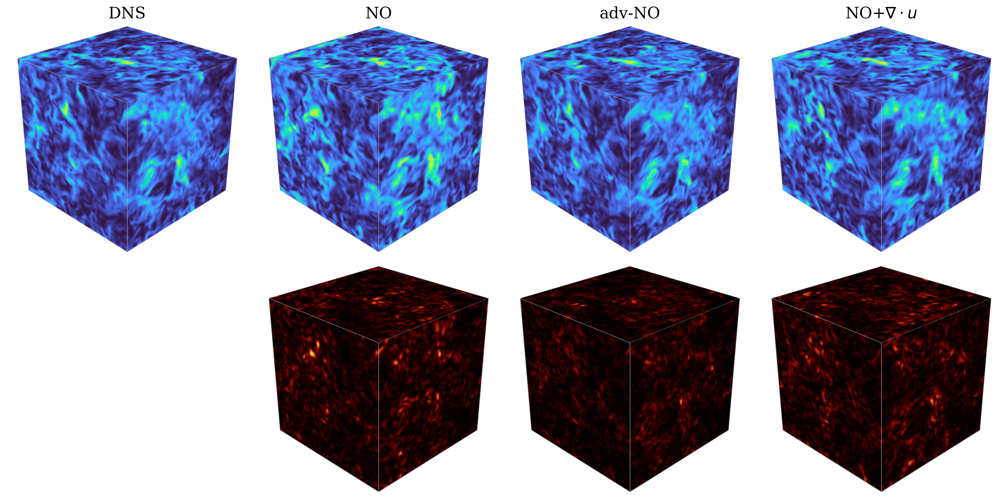

In [24]:
sample_id = 0
f_id = 0

fig, axes = plt.subplots(2,4, figsize=(16,8))

VMIN_ls = np.min(ke_ls[0]) #, axis=(0,3,4,5))
VMAX_ls = np.max(ke_ls[0]) #, axis=(0,3,4,5))
# cmap_ls = ['ocean', 'afmhot', 'cividis', 'magma']
cmap_ls = ['turbo', 'turbo', 'turbo', 'turbo', 'turbo']
# title_ls = ['u', 'v', 'w', 'P']
title_ls = [r'$t=1 t_E$', r'$t=2 t_E$',r'$t=3 t_E$',r'$t=4 t_E$',r'$t=5 t_E$']

t_id = 13


row_id = 0
for i in range(4):
    VMIN = VMIN_ls#[f_id, t_id]
    VMAX = VMAX_ls#[f_id, t_id]

    # field = pred_ls[i][sample_id, f_id, t_id]
    # field = 1/2 * (pred_ls[i][sample_id, 0, t_id]**2 + pred_ls[i][sample_id, 1, t_id]**2 + pred_ls[i][sample_id, 2, t_id]**2)
    field = ke_ls[i][sample_id, f_id, t_id]
    image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], opacity=1, show_colorbar=False)
    # image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id])

    ax = axes[row_id, i]
    ax.set_axis_off()
    # ax.set_xticks([])
    # ax.set_yticks([])
    ax.imshow(image)

    if i==0:
        ax.set_ylabel(f'KE ('+r'$t=2 t_E$'+f')', fontsize=18)

    ax.set_title(pred_label_ls[i], fontsize=18)

VMIN_LS = []
VMAX_LS = []
for i in range(1,4,1):
    temp = np.abs(ke_ls[i][sample_id, f_id, t_id] - ke_ls[0][sample_id, f_id, t_id])
    VMIN_LS.append(np.min(temp))
    VMAX_LS.append(np.max(temp))

VMIN = np.min(VMIN_LS)
VMAX = np.min(VMAX_LS)

row_id = 1 
for i in range(4):
    ax=axes[row_id, i]
    if i==0:
        ax.set_axis_off()
        continue

    field = np.abs(ke_ls[i][sample_id, f_id, t_id] - ke_ls[0][sample_id, f_id, t_id])
    image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP='afmhot', opacity=1, show_colorbar=False)

    ax.set_axis_off()
    # ax.set_xticks([])
    # ax.set_yticks([])
    ax.imshow(image)

    if i==1:
        ax.set_ylabel(f'Absolute Error', fontsize=18)

plt.tight_layout()
plt.show()


In [25]:
import matplotlib as mpl

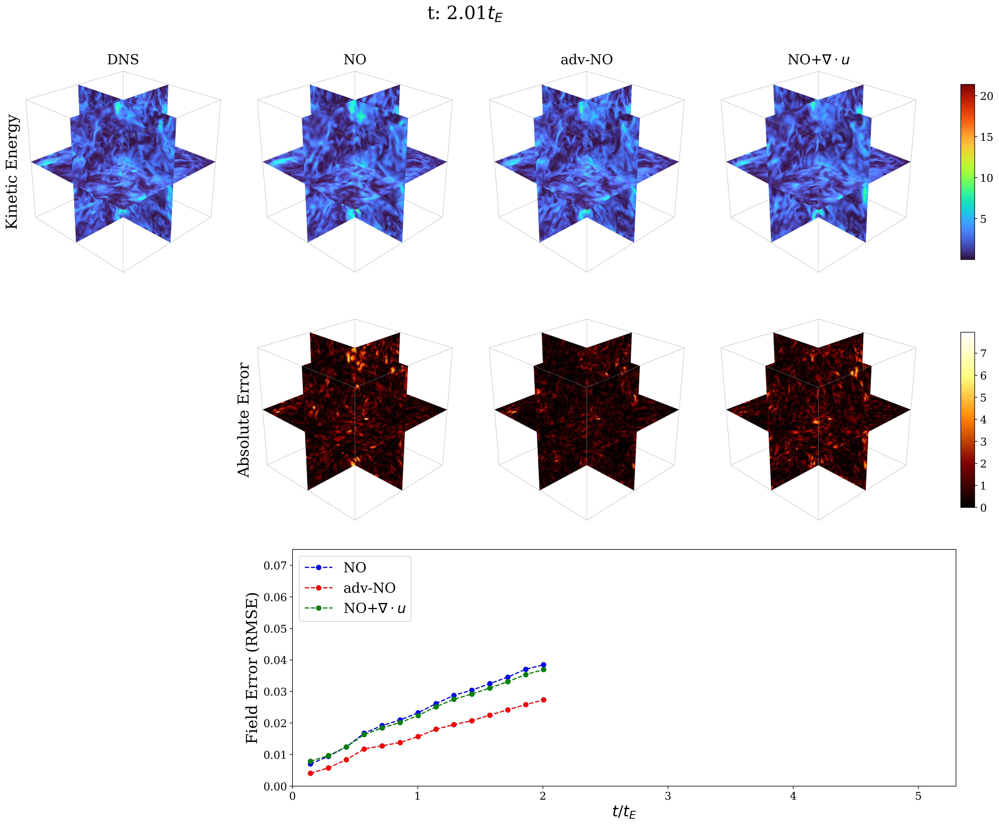

In [26]:
import matplotlib.gridspec as gridspec

sample_id = 0
f_id = 0

# Create figure using GridSpec for flexible subplot merging
fig = plt.figure(figsize=(17, 14))
gs = gridspec.GridSpec(3, 4, figure=fig)

# Create 3x4 axes but merge axes[2,0] and axes[2,1]
axes = np.empty((3,4), dtype=object)

# First row — individual axes
for i in range(4):
    axes[0, i] = fig.add_subplot(gs[0, i])

# Second row — individual axes
for i in range(4):
    axes[1, i] = fig.add_subplot(gs[1, i])

# Third row — merge axes[2,0] and axes[2,1]
axes[2, 0] = fig.add_subplot(gs[2, 0])   # merged big subplot
axes[2, 1] = fig.add_subplot(gs[2, 1:4])                         # placeholder for merged
axes[2, 2] = None    # separate small subplot
axes[2, 3] = None    # separate small subplot

# --------------------------------------------------------
# --------------- First Row (Kinetic Energy) -------------
# --------------------------------------------------------
VMIN_ls = np.min(ke_ls[0])
VMAX_ls = np.max(ke_ls[0])
cmap_ls = ['turbo', 'turbo', 'turbo', 'turbo', 'turbo']
t_id = 13

row_id = 0
for i in range(4):
    VMIN = VMIN_ls
    VMAX = VMAX_ls
    field = ke_ls[i][sample_id, f_id, t_id]
    # image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], opacity=1, show_colorbar=False)
    image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP=cmap_ls[f_id], show_colorbar=False)

    ax = axes[row_id, i]
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])

    for spine in ax.spines.values():
        spine.set_visible(False)

    if i == 0:
        ax.set_ylabel('Kinetic Energy', fontsize=20)
    ax.set_title(pred_label_ls[i], fontsize=18)

# --------------------------------------------------------
# --------------- Second Row (Absolute Error) ------------
# --------------------------------------------------------
VMIN_LS, VMAX_LS = [], []
for i in range(1,4,1):
    temp = np.abs(ke_ls[i][sample_id, f_id, t_id] - ke_ls[0][sample_id, f_id, t_id])
    VMIN_LS.append(np.min(temp))
    VMAX_LS.append(np.max(temp))

VMIN = np.min(VMIN_LS)
VMAX = np.min(VMAX_LS)

row_id = 1
for i in range(0,4,1):
    
    ax = axes[row_id, i]
    if i==0:
        ax.set_axis_off()
        continue
        
    field = np.abs(ke_ls[i][sample_id, f_id, t_id] - ke_ls[0][sample_id, f_id, t_id])
    # image = plot_volume_rendering(field, clim=[VMIN,VMAX], CMAP='afmhot', opacity=1, show_colorbar=False)
    image = plot_midplane_slices(field, clim=[VMIN,VMAX], CMAP='afmhot', show_colorbar=False)

    ax.imshow(image)
    
    ax.set_xticks([])
    ax.set_yticks([])

    for spine in ax.spines.values():
        spine.set_visible(False)

    if i == 1:
        ax.set_ylabel('Absolute Error', fontsize=20)

# --------------------------------------------------------
# --------------- Colorbars ------------------------------
# --------------------------------------------------------
plt.tight_layout()
fig.canvas.draw_idle()

pos_top = axes[0, 3].get_position()
pos_bot = axes[1, 3].get_position()

pad = 0.045
width = 0.015

# Top colorbar
cax_top = fig.add_axes([pos_top.x1 + pad, pos_top.y0, width, pos_top.height])
# Bottom colorbar
cax_bot = fig.add_axes([pos_bot.x1 + pad, pos_bot.y0, width, pos_bot.height])

# Adjust heights
shrink_factor = 0.85
for cax in [cax_top, cax_bot]:
    pos = cax.get_position()
    new_height = pos.height * shrink_factor
    y_centered = pos.y0 + (pos.height - new_height) / 2
    cax.set_position([pos.x0, y_centered, pos.width, new_height])

# Colorbar 1 — KE
norm1 = mpl.colors.Normalize(vmin=VMIN_ls, vmax=VMAX_ls)
sm1 = mpl.cm.ScalarMappable(norm=norm1, cmap='turbo')
sm1.set_array([])
cbar1 = fig.colorbar(sm1, cax=cax_top)
cbar1.ax.tick_params(labelsize=14)

# Colorbar 2 — Abs Error
norm2 = mpl.colors.Normalize(vmin=VMIN, vmax=VMAX)
sm2 = mpl.cm.ScalarMappable(norm=norm2, cmap='afmhot')
sm2.set_array([])
cbar2 = fig.colorbar(sm2, cax=cax_bot)
cbar2.ax.tick_params(labelsize=14)

# --------------------------------------------------------
# --------------- Third Row (Merged Axes) ----------------
# --------------------------------------------------------
ax = axes[2, 0]  # merged big subplot
ax.set_axis_off()
# for k in range(len(pred_ls)):
#     ax.loglog(wave_numbers, spectrum_ls[k][t_id],
#               label=pred_label_ls[k],
#               color=color_ls[k],
#               lw=lw_ls[k],
#               ls=ls_ls[k])

# ax.loglog(wave_numbers, 10 * wave_numbers**(-5/3),
#           label="slope = -5/3", color="magenta", ls="dotted")
# ax.set_xlabel("k", fontsize=20)
# ax.set_ylabel("E(k)", fontsize=20)
# ax.set_ylim(10**-12, 1.5*10**1)
# ax.legend(fontsize=16)
# ax.tick_params(axis='both', which='major', labelsize=14)




def get_err(true, pred):
    # true = 0.5 * (TRUE[0]**2 + TRUE[1]**2 + TRUE[2]**2)
    # pred = 0.5 * (PRED[0]**2 + PRED[1]**2 + PRED[2]**2)

    MIN = np.min(true)
    MAX = np.max(true)

    true = (true-MIN)/(MAX - MIN)
    pred = (pred-MIN)/(MAX - MIN)
    
    err = np.sqrt( np.mean( (true-pred)**2, axis=(1,2,3)  ) ) #/ np.sqrt( np.mean( (true)**2, axis=(1,2,3)  ) )
    # err = np.mean(err, axis=(0))
    return err


pos = axes[2,1].get_position()
axes[2,1].set_position([pos.x0 + 0.04, pos.y0, pos.width, pos.height])


ax = axes[2,1]
t_ls = (1+np.arange(true.shape[2]))
time_ls = t_ls * 0.04/TE1

for i in range(1, len(pred_ls)):
    err = get_err(ke_ls[0][0,0], ke_ls[i][0,0])
    ax.plot(time_ls[:t_id+1], err[:t_id+1],  marker='o', color=color_ls[i], ls=ls_ls[i], lw=lw_ls[i], label=f"{pred_label_ls[i]}")

ax.set_xticks([0,1,2,3,4,5])
ax.set_ylabel(f"Field Error (RMSE)", fontsize=20)
ax.set_xlabel(f"$t$/$t_E$", fontsize=20)
ax.set_ylim(0,0.075)
ax.set_xlim(0,5.3)
ax.legend(fontsize=18, loc="upper left")
ax.tick_params(axis='both', which='major', labelsize=14)

fig.suptitle(f"t: {time_ls[t_id]:.2f}"+r"$t_E$", fontsize=24, y=1.04)

plt.show()
